<a href="https://colab.research.google.com/github/sjkim-audio/guitar-bass-separator/blob/main/notebooks/source_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [7]:
# 구글 공유 드라이브에 있는 오디오 파일 다운로드

import gdown
import librosa
from IPython.display import Audio

# 1. 구글 드라이브 공유 링크에서 'FILE_ID' 부분만 추출
# 예: https://drive.google.com/file/d/1A2B3C.../view -> '1A2B3C...'
file_id = '1bjwVU8lThj2E1TDs1rwhZwZTcUgTOASc'

# 2. 다운로드할 URL 구성
url = f'https://drive.google.com/uc?id={file_id}'

# 3. 파일 저장 경로 및 이름 설정
output_filename = 'downloaded_audio.wav'

# 4. 파일 다운로드
gdown.download(url, output_filename, quiet=False)

# 5. 다운로드한 파일 로드 (48kHz 설정)
# y: 오디오 데이터, sr: 샘플링 레이트 (해당 음원은 48kHz로 렌더링됨)
try:
    y, sr = librosa.load(output_filename, sr=None)
    print(f"샘플링 레이트 {sr}Hz")
    print(f"오디오 길이: {len(y) / sr:.2f}초")
except FileNotFoundError:
    print("파일을 찾을 수 없습니다. 경로를 확인해주세요.")

Audio(data=y, rate=sr)

Downloading...
From: https://drive.google.com/uc?id=1bjwVU8lThj2E1TDs1rwhZwZTcUgTOASc
To: /content/downloaded_audio.wav
100%|██████████| 15.7M/15.7M [00:00<00:00, 163MB/s]


샘플링 레이트 48000Hz
오디오 길이: 54.68초


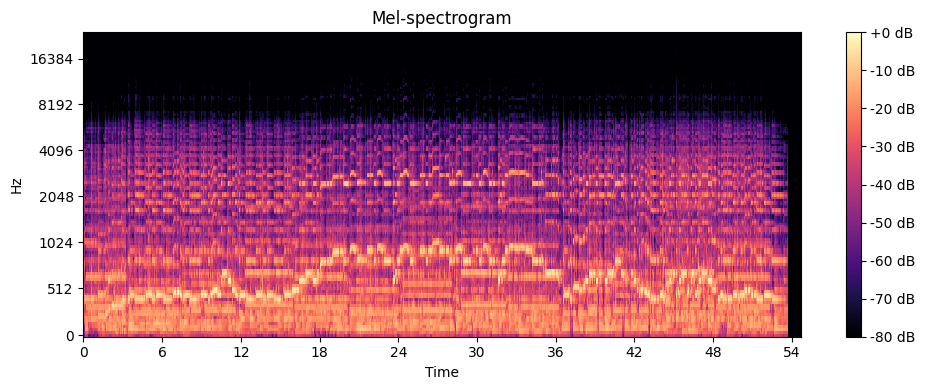

In [8]:
# 다운받은 오디오 데이터 멜스펙트로그램 시각화
import matplotlib.pyplot as plt
import librosa.display
import numpy as np

# 1. 멜 스펙트로그램 계산
# n_mels: 멜 필터의 개수 (보통 128개 사용)
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128)

# 2. 데시벨(dB) 스케일로 변환
# 스펙트로그램의 진폭을 로그 스케일(dB)로 변환하여 시각화 효과를 높입니다.
S_dB = librosa.power_to_db(S, ref=np.max)

# 3. 시각화
plt.figure(figsize=(10, 4))
librosa.display.specshow(S_dB, sr=sr, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')
plt.title('Mel-spectrogram')
plt.tight_layout()
plt.show()

In [12]:
# 고전 DSP 주파수 필터링만을 이용한 기타 베이스 분리
from scipy.signal import butter, filtfilt
from IPython.display import Audio, display

# 1. 버터워스 필터 함수 정의
def apply_filter(data, cutoff, sr, filter_type, order=5):
    nyquist = 0.5 * sr
    normal_cutoff = cutoff / nyquist
    # b, a: 필터 계수 계산
    b, a = butter(order, normal_cutoff, btype=filter_type, analog=False)
    # filtfilt: 위상 왜곡을 방지하기 위해 앞뒤로 두 번 필터링 적용
    return filtfilt(b, a, data)

# 2. 파라미터 설정
cutoff_freq = 250  # 기준 주파수 (Hz). 이 값을 조절하며 결과를 비교

# 3. 필터 적용 (이전 단계의 y, sr 사용)
# 베이스: 기준 주파수 이하만 통과 (Low Pass)
bass_part = apply_filter(y, cutoff_freq, sr, 'low')

# 기타: 기준 주파수 이상만 통과 (High Pass)
guitar_part = apply_filter(y, cutoff_freq, sr, 'high')

# 4. 결과 출력 및 청취
print(f"🔹 기준 주파수: {cutoff_freq}Hz")

print("\n🎸 Extracted Bass (LPF):")
display(Audio(bass_part, rate=sr))

print("\n🎸 Extracted Guitar (HPF):")
display(Audio(guitar_part, rate=sr))

🔹 기준 주파수: 250Hz

🎸 Extracted Bass (LPF):



🎸 Extracted Guitar (HPF):


**Frequency Filtering**

Butterworth 필터를 이용해 주파수만으로 기타와 베이스를 분리하는 실습

**1. 사용기술**

**- LPF (Low Pass Filter):** 낮은 주파수만 통과시킵니다. → 베이스 분리용

**- HPF (High Pass Filter):** 높은 주파수만 통과시킵니다. → 기타 분리용


**2. 실습 결과**

Cutoff Frequency에 따른 분리도 변화
1) 100 ~ 200Hz
- 베이스 트랙: 노트를 인식하기 어렵지만 기타 소리가 넘어오진 않음 -> bleeding 없음
- 기타 트랙: 기타 소스는 일반적인 로우컷을 한 것처럼 깔끔함.


2) 250 ~ 300Hz:
- 베이스 트랙: 200Hz 대비좀 더 베이스의 라인을 인식하기 쉬워짐. 그러나 기타 소리가 세어나옴 -> bleeding 발생
250Hz 부터 미세하게 세컨기타의 타격 성분과 퍼스트 라인을 인식할 수 있음.
- 기타 트랙: 200Hz에 비해 세컨 기타의 타격 성분이 많이 줄어들었음